In [2]:
import os
import zipfile
import numpy as np
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
import cv2
import matplotlib.pyplot as plt
import nibabel as nib
import numpy as np
import tensorflow as tf
from ipywidgets import IntSlider, interact
from matplotlib import animation, rc
from matplotlib.patches import PathPatch, Rectangle
from matplotlib.path import Path
from scipy import ndimage
from scipy.ndimage import zoom
from tensorflow.keras import Input, Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import (BatchNormalization, Conv3D, Dense,
                                     Dropout, GlobalAveragePooling3D,
                                     MaxPool3D)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import ExponentialDecay

In [3]:
1

1

In [4]:
# Download url of normal CT scans.
url = "https://github.com/hasibzunair/3D-image-classification-tutorial/releases/download/v0.2/CT-0.zip"
filename = os.path.join(os.getcwd(), "CT-0.zip")
keras.utils.get_file(filename, url)

# Download url of abnormal CT scans.
url = "https://github.com/hasibzunair/3D-image-classification-tutorial/releases/download/v0.2/CT-23.zip"
filename = os.path.join(os.getcwd(), "CT-23.zip")
keras.utils.get_file(filename, url)

1045162547/1045162547 [==============================] - 3s 0us/step


'/kaggle/working/CT-23.zip'

In [5]:
os.makedirs("MosMedData")

In [6]:
!pip install nibabel

# Unzip data in the newly created directory.
with zipfile.ZipFile("CT-0.zip", "r") as z_fp:
    z_fp.extractall("/kaggle/working/MosMedData/")

with zipfile.ZipFile("CT-23.zip", "r") as z_fp:
    z_fp.extractall("/kaggle/working/MosMedData/")

In [7]:
import nibabel as nib

from scipy import ndimage


def read_nifti_file(filepath):
    """Read and load volume"""
    # Read file
    scan = nib.load(filepath)
    # Get raw data
    scan = scan.get_fdata()
    return scan


def normalize(volume):
    """Normalize the volume"""
    min = -1000
    max = 400
    volume[volume < min] = min
    volume[volume > max] = max
    volume = (volume - min) / (max - min)
    volume = volume.astype("float32")
    return volume


def resize_volume(img):
    """Resize across z-axis"""
    # Set the desired depth
    desired_depth = 64
    desired_width = 128
    desired_height = 128
    # Get current depth
    current_depth = img.shape[-1]
    current_width = img.shape[0]
    current_height = img.shape[1]
    # Compute depth factor
    depth = current_depth / desired_depth
    width = current_width / desired_width
    height = current_height / desired_height
    depth_factor = 1 / depth
    width_factor = 1 / width
    height_factor = 1 / height
    # Rotate
    img = ndimage.rotate(img, 90, reshape=False)
    # Resize across z-axis
    img = ndimage.zoom(img, (width_factor, height_factor, depth_factor), order=1)
    return img


def process_scan(path):
    """Read and resize volume"""
    # Read scan
    volume = read_nifti_file(path)
    # Normalize
    volume = normalize(volume)
    # Resize width, height and depth
    volume = resize_volume(volume)
    return volume

In [8]:
# Folder "CT-0" consist of CT scans having normal lung tissue,
# no CT-signs of viral pneumonia.
normal_scan_paths = [
    os.path.join(os.getcwd(), "MosMedData/CT-0", x)
    for x in os.listdir("MosMedData/CT-0")
]
# Folder "CT-23" consist of CT scans having several ground-glass opacifications,
# involvement of lung parenchyma.
abnormal_scan_paths = [
    os.path.join(os.getcwd(), "MosMedData/CT-23", x)
    for x in os.listdir("MosMedData/CT-23")
]

print("CT scans with normal lung tissue: " + str(len(normal_scan_paths)))
print("CT scans with abnormal lung tissue: " + str(len(abnormal_scan_paths)))

CT scans with normal lung tissue: 100
CT scans with abnormal lung tissue: 100


In [9]:
# Read and process the scans.
# Each scan is resized across height, width, and depth and rescaled.
abnormal_scans = np.array([process_scan(path) for path in abnormal_scan_paths])
normal_scans = np.array([process_scan(path) for path in normal_scan_paths])

# For the CT scans having presence of viral pneumonia
# assign 1, for the normal ones assign 0.
abnormal_labels = np.array([1 for _ in range(len(abnormal_scans))])
normal_labels = np.array([0 for _ in range(len(normal_scans))])

# Split data in the ratio 70-30 for training and validation.
x_train = np.concatenate((abnormal_scans[:70], normal_scans[:70]), axis=0)
y_train = np.concatenate((abnormal_labels[:70], normal_labels[:70]), axis=0)
x_val = np.concatenate((abnormal_scans[70:], normal_scans[70:]), axis=0)
y_val = np.concatenate((abnormal_labels[70:], normal_labels[70:]), axis=0)
print(
    "Number of samples in train and validation are %d and %d."
    % (x_train.shape[0], x_val.shape[0])
)

Number of samples in train and validation are 140 and 60.


In [10]:
import random

from scipy import ndimage


@tf.function
def rotate(volume):
    """Rotate the volume by a few degrees"""

    def scipy_rotate(volume):
        # define some rotation angles
        angles = [-20, -10, -5, 5, 10, 20]
        # pick angles at random
        angle = random.choice(angles)
        # rotate volume
        volume = ndimage.rotate(volume, angle, reshape=False)
        volume[volume < 0] = 0
        volume[volume > 1] = 1
        return volume

    augmented_volume = tf.numpy_function(scipy_rotate, [volume], tf.float32)
    return augmented_volume


def train_preprocessing(volume, label):
    """Process training data by rotating and adding a channel."""
    # Rotate volume
    volume = rotate(volume)
    volume = tf.expand_dims(volume, axis=3)
    return volume, label


def validation_preprocessing(volume, label):
    """Process validation data by only adding a channel."""
    volume = tf.expand_dims(volume, axis=3)
    return volume, label

In [11]:
# Define data loaders.
train_loader = tf.data.Dataset.from_tensor_slices((x_train, y_train))
validation_loader = tf.data.Dataset.from_tensor_slices((x_val, y_val))

batch_size = 2
# Augment the on the fly during training.
train_dataset = (
    train_loader.shuffle(len(x_train))
    .map(train_preprocessing)
    .batch(batch_size)
    .prefetch(2)
)
# Only rescale.
validation_dataset = (
    validation_loader.shuffle(len(x_val))
    .map(validation_preprocessing)
    .batch(batch_size)
    .prefetch(2)
)

Dimension of the CT scan is: (128, 128, 64, 1)


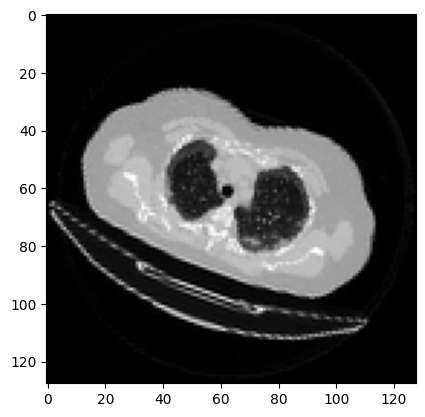

In [12]:
import matplotlib.pyplot as plt

data = train_dataset.take(1)
images, labels = list(data)[0]
images = images.numpy()
image = images[0]
print("Dimension of the CT scan is:", image.shape)
plt.imshow(np.squeeze(image[:, :, 50]), cmap="gray")

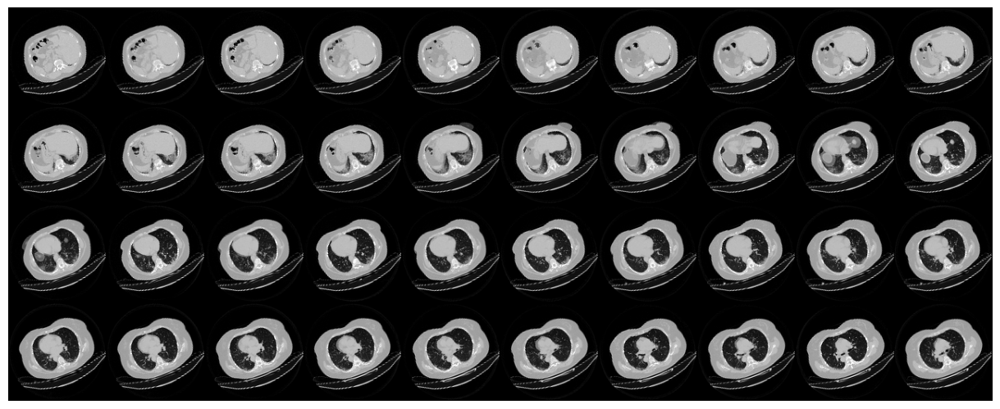

In [13]:
def plot_slices(num_rows, num_columns, width, height, data):
    """Plot a montage of 20 CT slices"""
    data = np.rot90(np.array(data))
    data = np.transpose(data)
    data = np.reshape(data, (num_rows, num_columns, width, height))
    rows_data, columns_data = data.shape[0], data.shape[1]
    heights = [slc[0].shape[0] for slc in data]
    widths = [slc.shape[1] for slc in data[0]]
    fig_width = 12.0
    fig_height = fig_width * sum(heights) / sum(widths)
    f, axarr = plt.subplots(
        rows_data,
        columns_data,
        figsize=(fig_width, fig_height),
        gridspec_kw={"height_ratios": heights},
    )
    for i in range(rows_data):
        for j in range(columns_data):
            axarr[i, j].imshow(data[i][j], cmap="gray")
            axarr[i, j].axis("off")
    plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)
    plt.show()


# Visualize montage of slices.
# 4 rows and 10 columns for 100 slices of the CT scan.
plot_slices(4, 10, 128, 128, image[:, :, :40])

In [14]:
def get_model(width=128, height=128, depth=64):
    """Build a 3D convolutional neural network model."""

    inputs = keras.Input((width, height, depth, 1))

    x = layers.Conv3D(filters=64, kernel_size=3, activation="relu")(inputs)
    x = layers.MaxPool3D(pool_size=2)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)


    x = layers.Conv3D(filters=64, kernel_size=3, activation="relu")(x)
    x = layers.MaxPool3D(pool_size=2)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)


    x = layers.Conv3D(filters=128, kernel_size=3, activation="relu")(x)
    x = layers.MaxPool3D(pool_size=2)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)


    x = layers.Conv3D(filters=256, kernel_size=3, activation="relu")(x)
    x = layers.MaxPool3D(pool_size=2)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)


    x = layers.GlobalAveragePooling3D()(x)
    x = layers.Dense(units=512, activation="relu")(x)
    x = layers.Dropout(0.3)(x)

    outputs = layers.Dense(units=1, activation="sigmoid")(x)

    # Define the model.
    model = keras.Model(inputs, outputs, name="3dcnn")
    return model


# Build model.
model = get_model(width=128, height=128, depth=64)
model.summary()

Model: "3dcnn"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 64, 1   0         
                             )]                                  
                                                                 
 conv3d (Conv3D)             (None, 126, 126, 62, 64   1792      
                             )                                   
                                                                 
 max_pooling3d (MaxPooling3  (None, 63, 63, 31, 64)    0         
 D)                                                              
                                                                 
 batch_normalization (Batch  (None, 63, 63, 31, 64)    256       
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 63, 63, 31, 64)    0     

In [15]:
# Compile model.
initial_learning_rate = 0.001
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate, decay_steps=100000, decay_rate=0.96, staircase=True
)
model.compile(
    loss="binary_crossentropy",
    optimizer=keras.optimizers.Adam(learning_rate=lr_schedule),
    metrics=["acc"],
)

# Define callbacks.
checkpoint_cb = keras.callbacks.ModelCheckpoint(
    "3d_image_classification.h5", save_best_only=True
)
early_stopping_cb = keras.callbacks.EarlyStopping(monitor="val_acc", patience=15)

# Train the model, doing validation at the end of each epoch
epochs = 100
model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=epochs,
    shuffle=True,
    verbose=2,
    callbacks=[checkpoint_cb, early_stopping_cb],
)

Epoch 1/100
70/70 - 466s - loss: 0.7284 - acc: 0.5786 - val_loss: 0.7851 - val_acc: 0.5000 - 466s/epoch - 7s/step


/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/100
70/70 - 484s - loss: 0.7041 - acc: 0.4714 - val_loss: 4.1872 - val_acc: 0.5000 - 484s/epoch - 7s/step
Epoch 3/100
70/70 - 504s - loss: 0.6467 - acc: 0.6500 - val_loss: 0.7620 - val_acc: 0.6333 - 504s/epoch - 7s/step
Epoch 4/100
70/70 - 487s - loss: 0.6615 - acc: 0.5857 - val_loss: 0.9202 - val_acc: 0.5000 - 487s/epoch - 7s/step
Epoch 5/100
70/70 - 478s - loss: 0.6504 - acc: 0.6143 - val_loss: 0.7032 - val_acc: 0.5500 - 478s/epoch - 7s/step
Epoch 6/100
70/70 - 476s - loss: 0.6766 - acc: 0.6071 - val_loss: 0.6757 - val_acc: 0.5333 - 476s/epoch - 7s/step
Epoch 7/100
70/70 - 476s - loss: 0.6197 - acc: 0.6429 - val_loss: 0.9165 - val_acc: 0.6167 - 476s/epoch - 7s/step
Epoch 8/100
70/70 - 477s - loss: 0.6887 - acc: 0.5929 - val_loss: 1.4874 - val_acc: 0.5000 - 477s/epoch - 7s/step
Epoch 9/100
70/70 - 477s - loss: 0.6845 - acc: 0.5929 - val_loss: 1.0110 - val_acc: 0.5500 - 477s/epoch - 7s/step
Epoch 10/100
70/70 - 478s - loss: 0.6202 - acc: 0.6500 - val_loss: 1.1665 - val_acc: 0.5

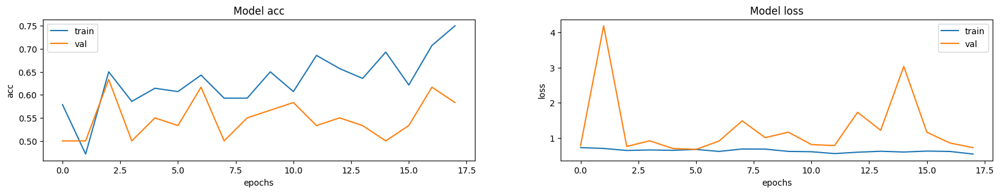

In [16]:
fig, ax = plt.subplots(1, 2, figsize=(20, 3))
ax = ax.ravel()

for i, metric in enumerate(["acc", "loss"]):
    ax[i].plot(model.history.history[metric])
    ax[i].plot(model.history.history["val_" + metric])
    ax[i].set_title("Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])

In [17]:
model.load_weights('/kaggle/working/3d_image_classification.h5')
input_volume = x_val[0]

prediction = model.predict(np.expand_dims(input_volume, axis=0))[0]
scores = [1 - prediction[0], prediction[0]]

class_names = ['normal', 'abnormal']
for score, name in zip(scores, class_names):
    print(
        f'This model is {(100 * score):.2f} percent confident that CT scan is {name}.'
    )

1/1 [==============================] - 1s 692ms/step
This model is 70.98 percent confident that CT scan is normal.
This model is 29.02 percent confident that CT scan is abnormal.


In [18]:
volume_size = input_volume.shape
last_conv_layer_name = 'conv3d_3'
from tensorflow.keras import Input, Model
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """Generate class activation heatmap"""
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = Model(
        [model.inputs], [model.get_layer(
            last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel (equivalent to global average pooling)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2, 3))

    # We multiply each channel in the feature map array
    # by 'how important this channel is' with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    # Notice that we clip the heatmap values, which is equivalent to applying ReLU
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [19]:
# Remove last layer's activation
model.layers[-1].activation = None

# Print what the top predicted class is
img_array = np.expand_dims(input_volume, axis=0)

preds = model.predict(img_array)
print('Predicted:', preds[0])



1/1 [==============================] - 1s 512ms/step
Predicted: [0.29022518]


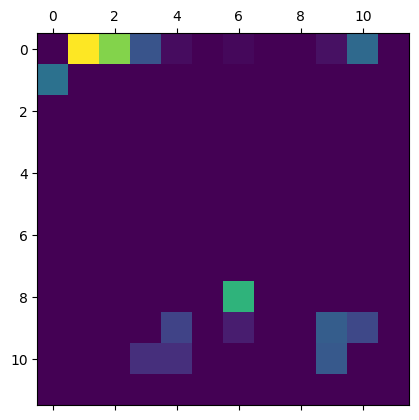

In [20]:
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
plt.matshow(np.squeeze(heatmap[:, :, 1]))
plt.show()

In [21]:
from scipy.ndimage import zoom
def get_resized_heatmap(heatmap, shape):
    """Resize heatmap to shape"""
    # Rescale heatmap to a range 0-255
    upscaled_heatmap = np.uint8(255 * heatmap)

    upscaled_heatmap = zoom(
        upscaled_heatmap,
        (
            shape[0] / upscaled_heatmap.shape[0],
            shape[1] / upscaled_heatmap.shape[1],
            shape[2] / upscaled_heatmap.shape[2],
        ),
    )

    return upscaled_heatmap


resized_heatmap = get_resized_heatmap(heatmap, input_volume.shape)

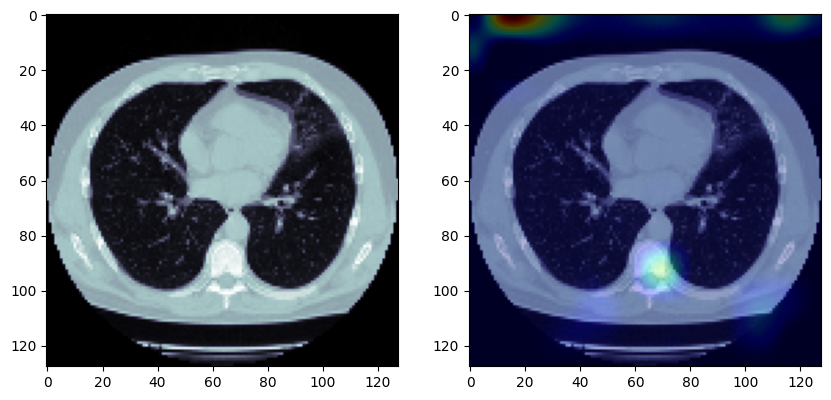

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(10, 20))

ax[0].imshow(np.squeeze(input_volume[:, :, 30]), cmap='bone')
img0 = ax[1].imshow(np.squeeze(input_volume[:, :, 30]), cmap='bone')
img1 = ax[1].imshow(np.squeeze(resized_heatmap[:, :, 30]),
                    cmap='jet', alpha=0.3, extent=img0.get_extent())
plt.show()

In [23]:
def get_bounding_boxes(heatmap, threshold=0.15, otsu=False):
    """Get bounding boxes from heatmap"""
    p_heatmap = np.copy(heatmap)

    if otsu:
        # Otsu's thresholding method to find the bounding boxes
        threshold, p_heatmap = cv2.threshold(
            heatmap, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
        )
    else:
        # Using a fixed threshold
        p_heatmap[p_heatmap < threshold * 255] = 0
        p_heatmap[p_heatmap >= threshold * 255] = 1

    # find the contours in the thresholded heatmap
    contours = cv2.findContours(p_heatmap, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours = contours[0] if len(contours) == 2 else contours[1]

    # get the bounding boxes from the contours
    bboxes = []
    for c in contours:
        x, y, w, h = cv2.boundingRect(c)
        bboxes.append([x, y, x + w, y + h])

    return bboxes


def get_bbox_patches(bboxes, color='r', linewidth=2):
    """Get patches for bounding boxes"""
    patches = []
    for bbox in bboxes:
        x1, y1, x2, y2 = bbox
        patches.append(
            Rectangle(
                (x1, y1),
                x2 - x1,
                y2 - y1,
                edgecolor=color,
                facecolor='none',
                linewidth=linewidth,
            )
        )
    return patches

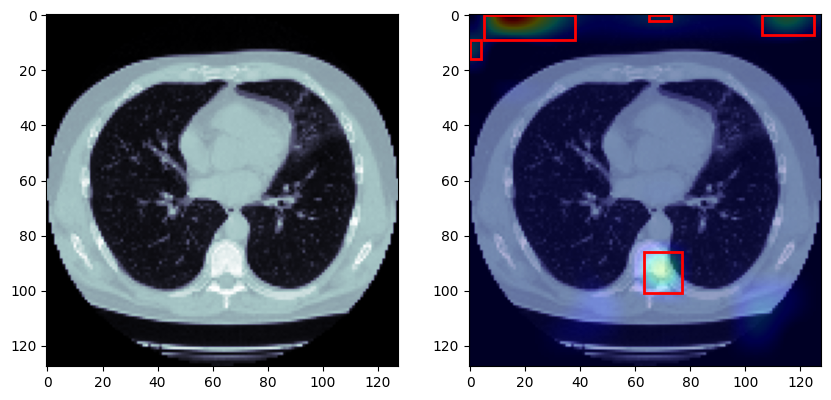

In [24]:
import cv2

# show the bounding boxes on the original image
fig, ax = plt.subplots(1, 2, figsize=(10, 20))

ax[0].imshow(np.squeeze(input_volume[:, :, 30]), cmap='bone')
img0 = ax[1].imshow(np.squeeze(input_volume[:, :, 30]), cmap='bone')
img1 = ax[1].imshow(np.squeeze(resized_heatmap[:, :, 30]),
                    cmap='jet', alpha=0.3, extent=img0.get_extent())

bboxes = get_bounding_boxes(np.squeeze(resized_heatmap[:, :, 30]))
patches = get_bbox_patches(bboxes)

for patch in patches:
    ax[1].add_patch(patch)

plt.show()

In [25]:
def _draw_line(ax, coords, clr='g'):
    line = Path(coords, [Path.MOVETO, Path.LINETO])
    pp = PathPatch(line, linewidth=3, edgecolor=clr, facecolor='none')
    ax.add_patch(pp)


def _set_axes_labels(ax, axes_x, axes_y):
    ax.set_xlabel(axes_x)
    ax.set_ylabel(axes_y)
    ax.set_aspect('equal', 'box')


def _draw_bboxes(ax, heatmap):
    bboxes = get_bounding_boxes(heatmap, otsu=True)
    patches = get_bbox_patches(bboxes)
    for patch in patches:
        ax.add_patch(patch)


_rec_prop = dict(linewidth=5, facecolor='none')


def show_volume(vol, z, y, x, heatmap=None, alpha=0.3, fig_size=(6, 6)):
    """Show a slice of a volume with optional heatmap"""
    fig, axarr = plt.subplots(nrows=2, ncols=2, figsize=fig_size)
    v_z, v_y, v_x = vol.shape

    img0 = axarr[0, 0].imshow(vol[z, :, :], cmap='bone')
    if heatmap is not None:
        axarr[0, 0].imshow(
            heatmap[z, :, :], cmap='jet', alpha=alpha, extent=img0.get_extent()
        )
        _draw_bboxes(axarr[0, 0], heatmap[z, :, :])

    axarr[0, 0].add_patch(Rectangle((-1, -1), v_x, v_y, edgecolor='r', **_rec_prop))
    _draw_line(axarr[0, 0], [(x, 0), (x, v_y)], 'g')
    _draw_line(axarr[0, 0], [(0, y), (v_x, y)], 'b')
    _set_axes_labels(axarr[0, 0], 'X', 'Y')

    img1 = axarr[0, 1].imshow(vol[:, :, x].T, cmap='bone')
    if heatmap is not None:
        axarr[0, 1].imshow(
            heatmap[:, :, x].T, cmap='jet', alpha=alpha, extent=img1.get_extent()
        )
        _draw_bboxes(axarr[0, 1], heatmap[:, :, x].T)

    axarr[0, 1].add_patch(Rectangle((-1, -1), v_z, v_y, edgecolor='g', **_rec_prop))
    _draw_line(axarr[0, 1], [(z, 0), (z, v_y)], 'r')
    _draw_line(axarr[0, 1], [(0, y), (v_x, y)], "b")
    _set_axes_labels(axarr[0, 1], 'Z', 'Y')

    img2 = axarr[1, 0].imshow(vol[:, y, :], cmap='bone')
    if heatmap is not None:
        axarr[1, 0].imshow(
            heatmap[:, y, :], cmap='jet', alpha=alpha, extent=img2.get_extent()
        )
        _draw_bboxes(axarr[1, 0], heatmap[:, y, :])

    axarr[1, 0].add_patch(Rectangle((-1, -1), v_x, v_z, edgecolor='b', **_rec_prop))
    _draw_line(axarr[1, 0], [(0, z), (v_x, z)], 'r')
    _draw_line(axarr[1, 0], [(x, 0), (x, v_y)], 'g')
    _set_axes_labels(axarr[1, 0], 'X', 'Z')
    axarr[1, 1].set_axis_off()
    fig.tight_layout()


def interactive_show(volume, heatmap=None):
    """Show a volume interactively"""
    # transpose volume from (x, y, z) to (z, y, x)
    volume = np.transpose(volume, (2, 0, 1))
    if heatmap is not None:
        heatmap = np.transpose(heatmap, (2, 0, 1))
    vol_shape = volume.shape

    interact(
        lambda x, y, z: plt.show(show_volume(volume, z, y, x, heatmap)),
        z=IntSlider(min=0, max=vol_shape[0] - 1, step=1, value=int(vol_shape[0] / 2)),
        y=IntSlider(min=0, max=vol_shape[1] - 1, step=1, value=int(vol_shape[1] / 2)),
        x=IntSlider(min=0, max=vol_shape[2] - 1, step=1, value=int(vol_shape[2] / 2)),
    )

In [26]:
interactive_show(input_volume)


interactive(children=(IntSlider(value=64, description='x', max=127), IntSlider(value=64, description='y', max=…

In [27]:
interactive_show(input_volume, resized_heatmap)


interactive(children=(IntSlider(value=64, description='x', max=127), IntSlider(value=64, description='y', max=…

In [28]:
rc('animation', html='jshtml')


def create_animation(array, case, heatmap=None, alpha=0.3):
    """Create an animation of a volume"""
    array = np.transpose(array, (2, 0, 1))
    if heatmap is not None:
        heatmap = np.transpose(heatmap, (2, 0, 1))
    fig = plt.figure(figsize=(4, 4))
    images = []
    for idx, image in enumerate(array):
        # plot image without notifying animation
        image_plot = plt.imshow(image, animated=True, cmap='bone')
        aux = [image_plot]
        if heatmap is not None:
            image_plot2 = plt.imshow(
                heatmap[idx], animated=True, cmap='jet', alpha=alpha, extent=image_plot.get_extent())
            aux.append(image_plot2)

            # add bounding boxes to the heatmap image as animated patches
            bboxes = get_bounding_boxes(heatmap[idx])
            patches = get_bbox_patches(bboxes)
            aux.extend(image_plot2.axes.add_patch(patch) for patch in patches)
        images.append(aux)

    plt.axis('off')
    plt.tight_layout()
    plt.subplots_adjust(top=0.90)
    plt.title(f'Patient ID: {case}', fontsize=16)
    ani = animation.ArtistAnimation(
        fig, images, interval=5000//len(array), blit=False, repeat_delay=1000)
    plt.close()
    return ani

In [29]:
create_animation(input_volume, 'Test')


In [30]:
create_animation(input_volume, 'Test', heatmap=resized_heatmap)
